<a href="https://colab.research.google.com/github/hildaeddi/porfolioproject/blob/main/Breast_Cancer_ML_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
pip install ucimlrepo


In [5]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
breast_cancer_wisconsin_diagnostic = fetch_ucirepo(id=17)

# data (as pandas dataframes)
X = breast_cancer_wisconsin_diagnostic.data.features
y = breast_cancer_wisconsin_diagnostic.data.targets

# metadata
print(breast_cancer_wisconsin_diagnostic.metadata)

# variable information
print(breast_cancer_wisconsin_diagnostic.variables)


{'uci_id': 17, 'name': 'Breast Cancer Wisconsin (Diagnostic)', 'repository_url': 'https://archive.ics.uci.edu/dataset/17/breast+cancer+wisconsin+diagnostic', 'data_url': 'https://archive.ics.uci.edu/static/public/17/data.csv', 'abstract': 'Diagnostic Wisconsin Breast Cancer Database.', 'area': 'Health and Medicine', 'tasks': ['Classification'], 'characteristics': ['Multivariate'], 'num_instances': 569, 'num_features': 30, 'feature_types': ['Real'], 'demographics': [], 'target_col': ['Diagnosis'], 'index_col': ['ID'], 'has_missing_values': 'no', 'missing_values_symbol': None, 'year_of_dataset_creation': 1993, 'last_updated': 'Fri Nov 03 2023', 'dataset_doi': '10.24432/C5DW2B', 'creators': ['William Wolberg', 'Olvi Mangasarian', 'Nick Street', 'W. Street'], 'intro_paper': {'title': 'Nuclear feature extraction for breast tumor diagnosis', 'authors': 'W. Street, W. Wolberg, O. Mangasarian', 'published_in': 'Electronic imaging', 'year': 1993, 'url': 'https://www.semanticscholar.org/paper/53

In [6]:
data_url= 'https://archive.ics.uci.edu/static/public/17/data.csv'

#importing dependencies

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier




#Reading and printing the dataset

In [8]:
breast_cancer_data = pd.read_csv(data_url)
#breast_cancer_data.head()
pd.set_option('display.max_columns', None)
print(breast_cancer_data)



           ID  radius1  texture1  perimeter1   area1  smoothness1  \
0      842302    17.99     10.38      122.80  1001.0      0.11840   
1      842517    20.57     17.77      132.90  1326.0      0.08474   
2    84300903    19.69     21.25      130.00  1203.0      0.10960   
3    84348301    11.42     20.38       77.58   386.1      0.14250   
4    84358402    20.29     14.34      135.10  1297.0      0.10030   
..        ...      ...       ...         ...     ...          ...   
564    926424    21.56     22.39      142.00  1479.0      0.11100   
565    926682    20.13     28.25      131.20  1261.0      0.09780   
566    926954    16.60     28.08      108.30   858.1      0.08455   
567    927241    20.60     29.33      140.10  1265.0      0.11780   
568     92751     7.76     24.54       47.92   181.0      0.05263   

     compactness1  concavity1  concave_points1  symmetry1  fractal_dimension1  \
0         0.27760     0.30010          0.14710     0.2419             0.07871   
1        

#Data pre-processing(checking for null values)

In [9]:
breast_cancer_data.shape
#breast_cancer_data.isnull().sum()

(569, 32)

In [10]:
breast_cancer_data.info

<bound method DataFrame.info of            ID  radius1  texture1  perimeter1   area1  smoothness1  \
0      842302    17.99     10.38      122.80  1001.0      0.11840   
1      842517    20.57     17.77      132.90  1326.0      0.08474   
2    84300903    19.69     21.25      130.00  1203.0      0.10960   
3    84348301    11.42     20.38       77.58   386.1      0.14250   
4    84358402    20.29     14.34      135.10  1297.0      0.10030   
..        ...      ...       ...         ...     ...          ...   
564    926424    21.56     22.39      142.00  1479.0      0.11100   
565    926682    20.13     28.25      131.20  1261.0      0.09780   
566    926954    16.60     28.08      108.30   858.1      0.08455   
567    927241    20.60     29.33      140.10  1265.0      0.11780   
568     92751     7.76     24.54       47.92   181.0      0.05263   

     compactness1  concavity1  concave_points1  symmetry1  fractal_dimension1  \
0         0.27760     0.30010          0.14710     0.2419             0.07871   
1         0.07864     0.08690          0.07017     0.1812             0.05667   
2         0.15990     0.19740          0.12790     0.2069             0.05999   
3         0.28390     0.24140          0.10520     0.2597             0.09744   
4         0.13280     0.19800          0.10430     0.1809             0.05883   
..            ...         ...              ...        ...                 ...   
564       0.11590     0.24390          0.13890     0.1726             0.05623   
565       0.10340     0.14400          0.09791     0.1752             0.05533   
566       0.10230     0.09251          0.05302     0.1590             0.05648   
567       0.27700     0.35140          0.15200     0.2397             0.07016   
568       0.04362     0.00000          0.00000     0.1587             0.05884   

     radius2  texture2  perimeter2   area2  smoothness2  compactness2  \
0     1.0950    0.9053       8.589  153.40     0.006399       0.04904   
1     0.5435    0.7339       3.398   74.08     0.005225       0.01308   
2     0.7456    0.7869       4.585   94.03     0.006150       0.04006   
3     0.4956    1.1560       3.445   27.23     0.009110       0.07458   
4     0.7572    0.7813       5.438   94.44     0.011490       0.02461   
..       ...       ...         ...     ...          ...           ...   
564   1.1760    1.2560       7.673  158.70     0.010300       0.02891   
565   0.7655    2.4630       5.203   99.04     0.005769       0.02423   
566   0.4564    1.0750       3.425   48.55     0.005903       0.03731   
567   0.7260    1.5950       5.772   86.22     0.006522       0.06158   
568   0.3857    1.4280       2.548   19.15     0.007189       0.00466   

     concavity2  concave_points2  symmetry2  fractal_dimension2  radius3  \
0       0.05373          0.01587    0.03003            0.006193   25.380   
1       0.01860          0.01340    0.01389            0.003532   24.990   
2       0.03832          0.02058    0.02250            0.004571   23.570   
3       0.05661          0.01867    0.05963            0.009208   14.910   
4       0.05688          0.01885    0.01756            0.005115   22.540   
..          ...              ...        ...                 ...      ...   
564     0.05198          0.02454    0.01114            0.004239   25.450   
565     0.03950          0.01678    0.01898            0.002498   23.690   
566     0.04730          0.01557    0.01318            0.003892   18.980   
567     0.07117          0.01664    0.02324            0.006185   25.740   
568     0.00000          0.00000    0.02676            0.002783    9.456   

     texture3  perimeter3   area3  smoothness3  compactness3  concavity3  \
0       17.33      184.60  2019.0      0.16220       0.66560      0.7119   
1       23.41      158.80  1956.0      0.12380       0.18660      0.2416   
2       25.53      152.50  1709.0      0.14440       0.42450      0.4504   
3       26.50       98.87   567.7      0.20980       0.86630      0.6869

In [11]:
breast_cancer_data.dtypes

ID                      int64
radius1               float64
texture1              float64
perimeter1            float64
area1                 float64
smoothness1           float64
compactness1          float64
concavity1            float64
concave_points1       float64
symmetry1             float64
fractal_dimension1    float64
radius2               float64
texture2              float64
perimeter2            float64
area2                 float64
smoothness2           float64
compactness2          float64
concavity2            float64
concave_points2       float64
symmetry2             float64
fractal_dimension2    float64
radius3               float64
texture3              float64
perimeter3            float64
area3                 float64
smoothness3           float64
compactness3          float64
concavity3            float64
concave_points3       float64
symmetry3             float64
fractal_dimension3    float64
Diagnosis              object
dtype: object

M = malignant cancer cells,
B = Benign cancer cells

In [12]:
breast_cancer_data['Diagnosis'].value_counts()

B    357
M    212
Name: Diagnosis, dtype: int64

Visualizing the count of the diagnosis result

<Axes: xlabel='count', ylabel='Diagnosis'>

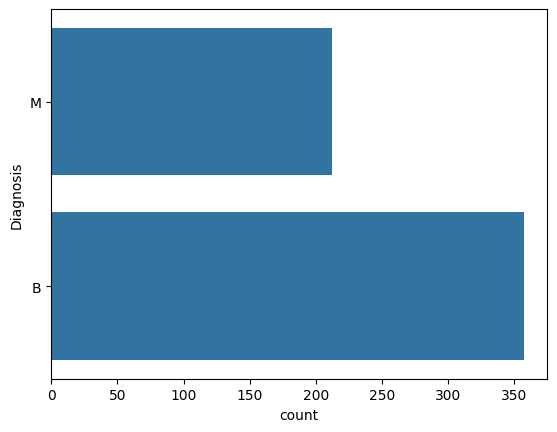

In [13]:
sns.countplot(breast_cancer_data['Diagnosis'],label ='count')

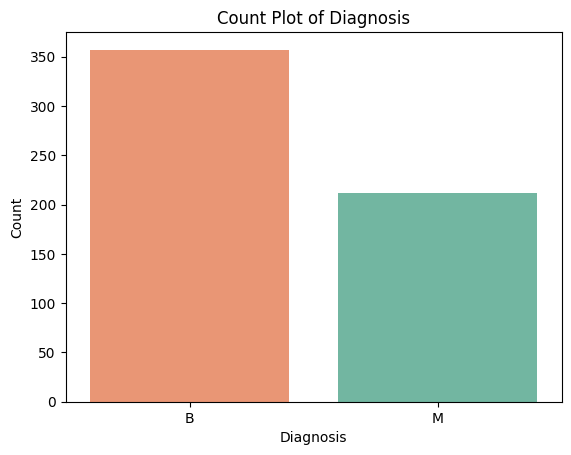

In [14]:

# Plot the count plot with different colors for each category
sns.countplot(x='Diagnosis',hue='Diagnosis', data=breast_cancer_data, palette='Set2', order=breast_cancer_data['Diagnosis'].value_counts().index, legend=False)
plt.ylabel('Count')
plt.xlabel('Diagnosis')
plt.title('Count Plot of Diagnosis')
plt.show()

Transform the target column to machine readable figures using the encoding method. B=0, M =1

In [15]:
from sklearn.preprocessing import LabelEncoder
labelencoder_Y = LabelEncoder()
breast_cancer_data.iloc[:,31] = labelencoder_Y.fit_transform(breast_cancer_data.iloc[:,31].values)

breast_cancer_data.iloc[:,31]

<ipython-input-15-ac846cddf3c9>:3: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  breast_cancer_data.iloc[:,31] = labelencoder_Y.fit_transform(breast_cancer_data.iloc[:,31].values)


0      1
1      1
2      1
3      1
4      1
      ..
564    1
565    1
566    1
567    1
568    0
Name: Diagnosis, Length: 569, dtype: int64

Creat pairplot and heat map for visualization

In [16]:
sns.pairplot(breast_cancer_data,hue='Diagnosis')
#plt.title('Pairplot of Selected Columns with Diagnosis Color Encoding')
#plt.show()

In [17]:
breast_cancer_data.iloc[:,1:32].corr()

,radius1,texture1,perimeter1,area1,smoothness1,compactness1,concavity1,concave_points1,symmetry1,fractal_dimension1,radius2,texture2,perimeter2,area2,smoothness2,compactness2,concavity2,concave_points2,symmetry2,fractal_dimension2,radius3,texture3,perimeter3,area3,smoothness3,compactness3,concavity3,concave_points3,symmetry3,fractal_dimension3,Diagnosis
radius1,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,-0.311631,0.679090,-0.097317,0.674172,0.735864,-0.222600,0.206000,0.194204,0.376169,-0.104321,-0.042641,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066,0.730029
texture1,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437,0.275869,0.386358,0.281673,0.259845,0.006614,0.191975,0.143293,0.163851,0.009127,0.054458,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205,0.415185
perimeter1,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,-0.261477,0.691765,-0.086761,0.693135,0.744983,-0.202694,0.250744,0.228082,0.407217,-0.081629,-0.005523,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019,0.742636
area1,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,-0.283110,0.732562,-0.066280,0.726628,0.800086,-0.166777,0.212583,0.207660,0.372320,-0.072497,-0.019887,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738,0.708984
smoothness1,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792,0.301467,0.068406,0.296092,0.246552,0.332375,0.318943,0.248396,0.380676,0.200774,0.283607,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316,0.358560
compactness1,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,0.565369,0.497473,0.046205,0.548905,0.455653,0.135299,0.738722,0.570517,0.642262,0.229977,0.507318,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382,0.596534
concavity1,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,0.336783,0.631925,0.076218,0.660391,0.617427,0.098564,0.670279,0.691270,0.683260,0.178009,0.449301,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930,0.696360
concave_points1,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,0.166917,0.698050,0.021480,0.710650,0.690299,0.027653,0.490424,0.439167,0.615634,0.095351,0.257584,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661,0.776614
symmetry1,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,0.479921,0.303379,0.128053,0.313893,0.223970,0.187321,0.421659,0.342627,0.393298,0.449137,0.331786,0.185728,0.090651,0.219169,0.177193,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413,0.330499
fractal_dimension1,-0.311631,-0.076437,-0.261477,-0.283110,0.584792,0.565369,0.336783,0.166917,0.479921,1.000000,0.000111,0.164174,0.039830,-0.090170,0.401964,0.559837,0.446630,0.341198,0.345007,0.688132,-0.253691,-0.051269,-0.205151,-0.231854,0.504942,0.458798,0.346234,0.175325,0.334019,0.767297,-0.012838


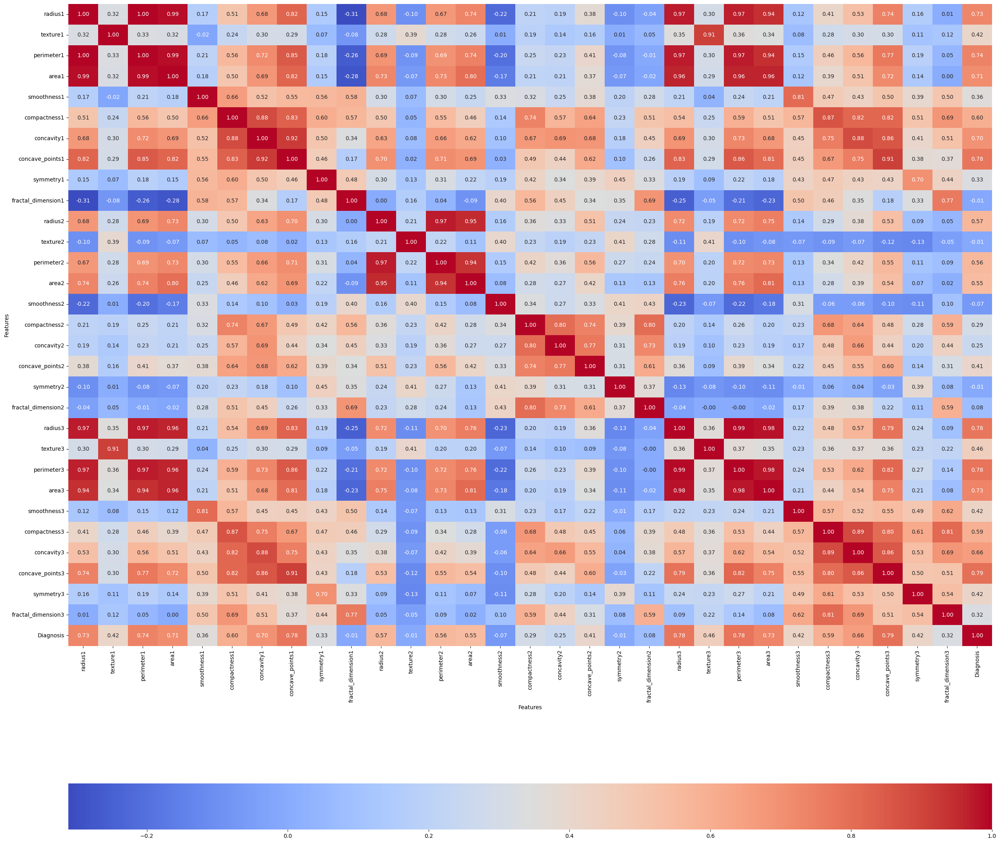

In [18]:
plt.figure(figsize=(30,30))
sns.heatmap(breast_cancer_data.iloc[:,1:32].corr(),annot=True, cmap='coolwarm', fmt=".2f",cbar_kws={'orientation': 'horizontal'})

# Set the title and labels
#plt.title('Correlation Heatmap')
plt.xlabel('Features')
plt.ylabel('Features')


plt.show()

#Split the data into target data and variable for training and testing the Machine model

In [19]:
X = breast_cancer_data.iloc[:,1:30].values
Y = breast_cancer_data.iloc[:,31].values

In [20]:
print(Y)

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 0 1 1 1 1 1 1 1 1 0 1 0 0 0 0 0 1 1 0 1 1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1 1
 0 1 0 1 1 0 0 0 1 1 0 1 1 1 0 0 0 1 0 0 1 1 0 0 0 1 1 0 0 0 0 1 0 0 1 0 0
 0 0 0 0 0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 0 1 1 0 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1
 0 1 0 0 0 1 0 0 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 0 1 0 1 1 1 1 0 0 1 1 0 0
 0 1 0 0 0 0 0 1 1 0 0 1 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 0 0 0 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 1 0 0
 0 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 1
 1 0 1 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0 0 0 0 1 0 0
 1 0 1 0 0 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0
 0 0 0 0 0 0 1 0 1 0 0 1 

In [21]:
print(X)

[[ 17.99    10.38   122.8    ...   0.7119   0.2654   0.4601]
 [ 20.57    17.77   132.9    ...   0.2416   0.186    0.275 ]
 [ 19.69    21.25   130.     ...   0.4504   0.243    0.3613]
 ...
 [ 16.6     28.08   108.3    ...   0.3403   0.1418   0.2218]
 [ 20.6     29.33   140.1    ...   0.9387   0.265    0.4087]
 [  7.76    24.54    47.92   ...   0.       0.       0.2871]]


In [22]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.20,random_state=42)

In [23]:
X_train.shape,X_test.shape,Y_train.shape,Y_test.shape

((455, 29), (114, 29), (455,), (114,))

In [24]:
X_train=StandardScaler().fit_transform(X_train)
X_test=StandardScaler().fit_transform(X_test)

In [25]:
# Train a Logistic Regression model
logistic_model = LogisticRegression(random_state=42)
logistic_model.fit(X_train, Y_train)

# Train a Decision Tree model
tree_model = DecisionTreeClassifier(random_state=42,criterion="entropy")
tree_model.fit(X_train, Y_train)

# Train a Random forest model
forest_model =RandomForestClassifier(n_estimators=100,random_state=42)
forest_model.fit(X_train,Y_train)


# Evaluate the models (optional)
train_accuracy_logistic = logistic_model.score(X_train, Y_train)
#test_accuracy_logistic = logistic_model.score(X_test, Y_test)
train_accuracy_tree = tree_model.score(X_train, Y_train)
#test_accuracy_tree = tree_model.score(X_test, Y_test)
train_accuracy_forest = forest_model.score(X_train, Y_train)
#test_accuracy_forest = forest_model.score(X_test, Y_test)

print("Logistic Regression Training Accuracy:", train_accuracy_logistic)
#print("Logistic Regression Test Accuracy:", test_accuracy_logistic)
print("Decision Tree Training Accuracy:", train_accuracy_tree)
#print("Decision Tree Test Accuracy:", test_accuracy_tree)
print("Random Forest Training Accuracy:", train_accuracy_forest)
#print("Random Forest Test Accuracy:", train_accuracy_forest)

Logistic Regression Training Accuracy: 0.9868131868131869
Decision Tree Training Accuracy: 1.0
Random Forest Training Accuracy: 1.0


tTesting our trained model with fresh data(testing data)

In [26]:
test_accuracy_logistic = logistic_model.score(X_test, Y_test)
test_accuracy_tree = tree_model.score(X_test, Y_test)
test_accuracy_forest = forest_model.score(X_test, Y_test)




print("Logistic Regression Test Accuracy:", test_accuracy_logistic)
print("Decision Tree Test Accuracy:", test_accuracy_tree)
print("Random Forest Test Accuracy:", train_accuracy_forest)


Logistic Regression Test Accuracy: 0.9824561403508771
Decision Tree Test Accuracy: 0.9473684210526315
Random Forest Test Accuracy: 1.0


#Building a prediction system

In [27]:
#Prediction with a Logistic Regression model

input_data = (20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,1.5950,0.7260,5.772,86.22,0.006522,0.06158,184.60,0.07117,0.01664,0.02324,0.006185,25.740,1821.0,39.42,184.60,1821.0,0.16500,0.86810,0.9387,)

#change the input data to a numpy array
input_data_as_numpy_array = np.asarray(input_data)

#reshape the numpy array as we are predicting for a one dataset
input_data_reshaped = input_data_as_numpy_array.reshape(1,-1)

logistic_model =LogisticRegression()
logistic_model.fit(X_train,Y_train)

prediction = logistic_model.predict(input_data_reshaped)
print (prediction)

if (prediction[0] == 0):
  print('The breast cancer is malignant')

else:
  print('The breast cancer is Benign')



[1]
The breast cancer is Benign


In [28]:
# Train a Decision Tree model
tree_model = DecisionTreeClassifier(random_state=42,criterion="entropy")
tree_model.fit(X_train, Y_train)

input_data = (20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,1.5950,0.7260,5.772,86.22,0.006522,0.06158,184.60,0.07117,0.01664,0.02324,0.006185,25.740,1821.0,39.42,184.60,1821.0,0.16500,0.86810,0.9387,)

#change the input data to a numpy array
input_data_as_numpy_array = np.asarray(input_data)

#reshape the numpy array as we are predicting for a one dataset
input_data_reshaped = input_data_as_numpy_array.reshape(1,-1)


tree_model = DecisionTreeClassifier()
tree_model.fit(X_train, Y_train)

prediction = tree_model.predict(input_data_reshaped)
print (prediction)

if (prediction[0] == 0):
  print('The breast cancer is malignant')

else:
  print('The breast cancer is Benign')

[0]
The breast cancer is malignant


In [29]:
input =(21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,1.1760,1.2560,7.673,158.70,0.010300,0.02891,0.05198,0.02454,0.01114,0.004239,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115)


#change the input data to a numpy array
input_data_as_numpy_array = np.asarray(input_data)

#reshape the numpy array as we are predicting for a one dataset
input_data_reshaped = input_data_as_numpy_array.reshape(1,-1)


tree_model = DecisionTreeClassifier()
tree_model.fit(X_train, Y_train)

prediction = tree_model.predict(input_data_reshaped)
print (prediction)

if (prediction[0] == 0):
  print('The breast cancer is malignant')

else:
  print('The breast cancer is Benign')


[0]
The breast cancer is malignant


In [30]:
# Train a Random forest model
forest_model =RandomForestClassifier(n_estimators=100,random_state=42)
forest_model.fit(X_train,Y_train)

input =(21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,1.1760,1.2560,7.673,158.70,0.010300,0.02891,0.05198,0.02454,0.01114,0.004239,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115)


#change the input data to a numpy array
input_data_as_numpy_array = np.asarray(input_data)

#reshape the numpy array as we are predicting for a one dataset
input_data_reshaped = input_data_as_numpy_array.reshape(1,-1)


tree_model = RandomForestClassifier()
tree_model.fit(X_train, Y_train)

prediction = forest_model.predict(input_data_reshaped)
print (prediction)

if (prediction[0] == 0):
  print('The breast cancer is malignant')

else:
  print('The breast cancer is Benign')




[1]
The breast cancer is Benign
